In [1]:
import numpy as np
import pandas as pd
import os

import matplotlib.pyplot as plt
import matplotlib

import soundfile as sf

import librosa
import librosa.display

import wave


import warnings
warnings.filterwarnings('ignore')


### Check data
|  |press|fret|string|
|---|---|---|---|
|검지|1|1|6|
|중시|0|0|0|
|약지|0|0|0|
|소지|0|0|0|

* 검지로 1번 프렛의 6번 줄을 누르고 있다

In [2]:
finger_gt_files = os.listdir("tablature_labels")


In [3]:
index_finger = []
middle_finger = []
ring_finger = []
pinkie_finger = []
len_data = []
finger_gt = []

root = "./tablature_labels/"
for idx in range(len(finger_gt_files)):
    snd_gt = np.load(root + str(idx) + ".npy")
    len_data.append(len(snd_gt))
    finger_gt.append(snd_gt)
    for snd in snd_gt:
        index_finger.append(snd[0])
        middle_finger.append(snd[1])
        ring_finger.append(snd[2])
        pinkie_finger.append(snd[3])

In [4]:
len_data

[120,
 120,
 120,
 120,
 120,
 120,
 120,
 120,
 120,
 60,
 60,
 60,
 60,
 60,
 60,
 60,
 60,
 60,
 45,
 55,
 55,
 55,
 55,
 55,
 55]

### wav cut

In [5]:
snd_pd = pd.read_csv("./timestamps.csv")

In [6]:
start = np.round(snd_pd.iloc[0]["timestamp"], 1)
end = np.round(snd_pd.iloc[4]["timestamp"], 1)
snd_root = "./tablature_audio/"
y, sr = librosa.load(snd_root + snd_pd.iloc[0]["audio"])

ny = y[int(start*sr) : int(end*sr)]
sf.write("test.wav", ny, sr, 'PCM_24')

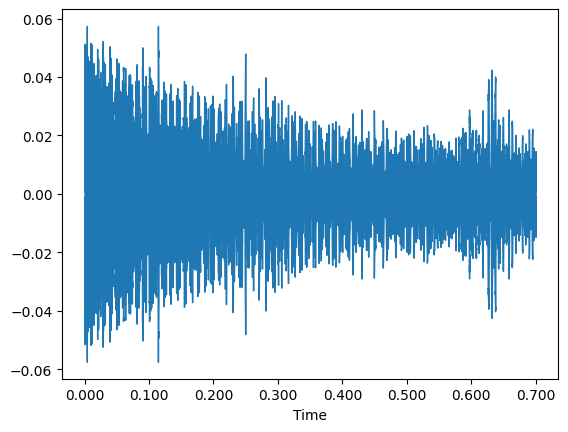

In [7]:
librosa.display.waveshow(ny)

### Make spectrogram

In [8]:
snd_files = os.listdir("./tablature_audio")

In [9]:
snd_dataset = {}
snd_root = "./tablature_audio/"
for guitar_snd in snd_files:
    y, sr = librosa.load(snd_root + guitar_snd)
    snd_dataset[guitar_snd] = y

In [10]:
snd_dataset['0.wav']

array([0.        , 0.        , 0.        , ..., 0.00188475, 0.00186991,
       0.00204017], dtype=float32)

In [11]:
snd_pd[snd_pd["audio"] == "0.wav"]

,frame,audio,timestamp
0,0_0.png,0.wav,5.735000
1,0_1.png,0.wav,5.901667
2,0_2.png,0.wav,6.068333
3,0_3.png,0.wav,6.235000
4,0_4.png,0.wav,6.401667
...,...,...,...
115,0_115.png,0.wav,33.338333
116,0_116.png,0.wav,33.505000
117,0_117.png,0.wav,33.671667
118,0_118.png,0.wav,33.838333


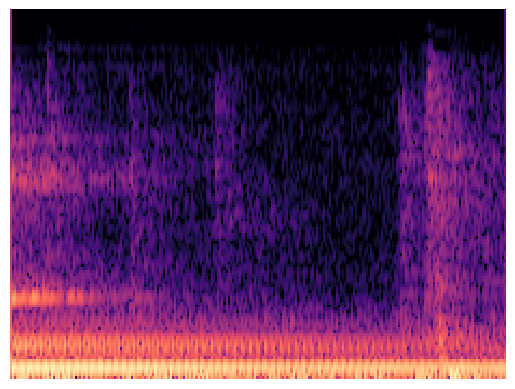

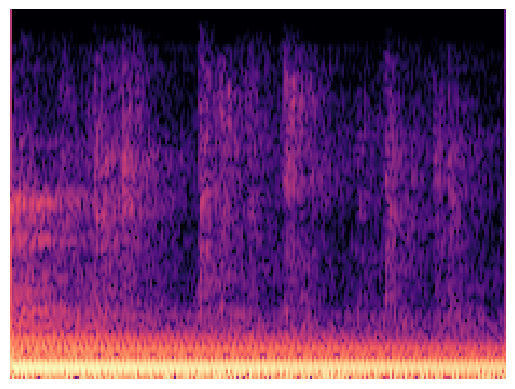

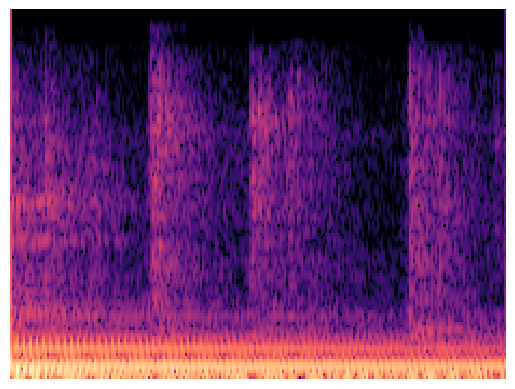

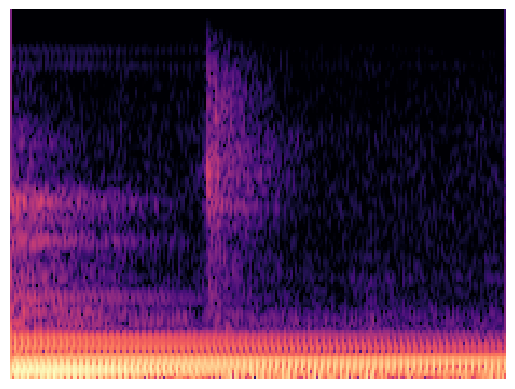

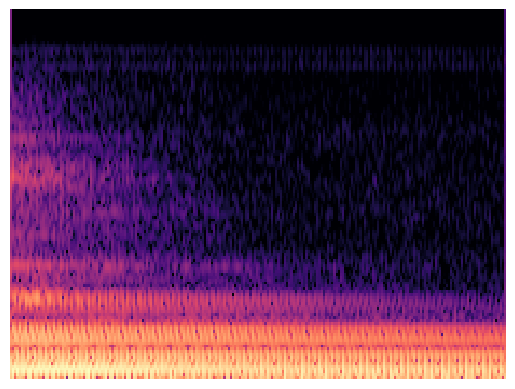

...

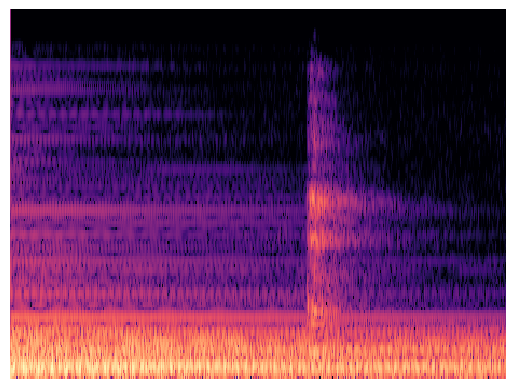

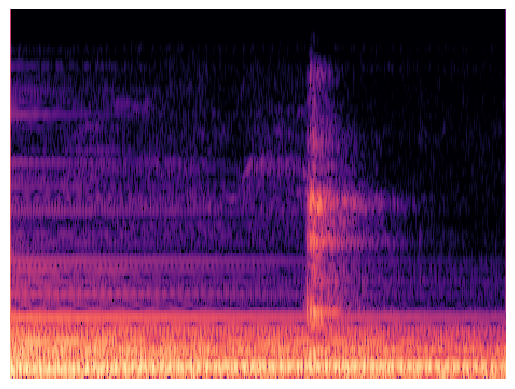

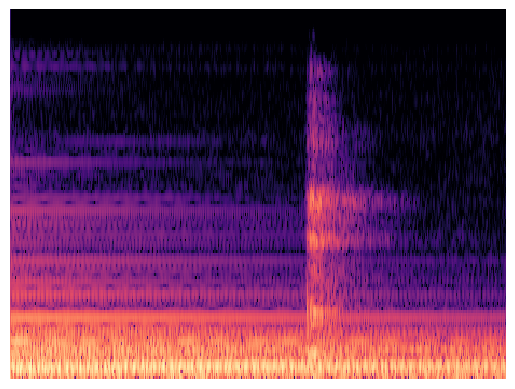

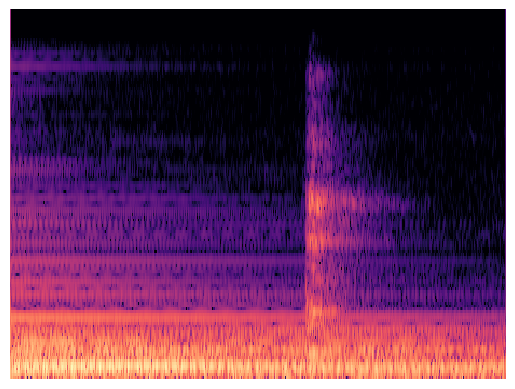

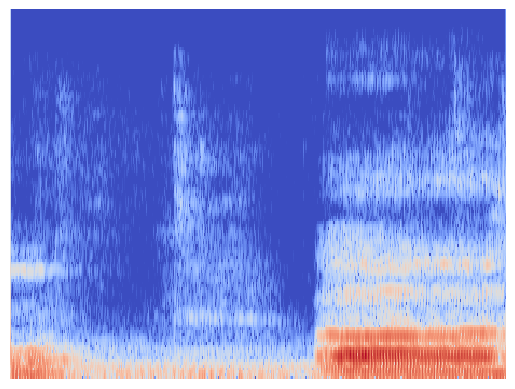

In [14]:
#len(snd_files)
start_list = []
end_list = []

png_path_list = []

index_finger_press = []
index_finger_pret = []
index_finger_string = []

middle_finger_press = []
middle_finger_pret = []
middle_finger_string = []

ring_finger_press = []
ring_finger_pret = []
ring_finger_string = []

pinkie_finger_press = []
pinkie_finger_pret = []
pinkie_finger_string = []

png_name_list = []


save_path = "./spectrogram/"
for idx in range(len(snd_files)):
    file = "%d.wav" % idx
    pd_ = snd_pd[snd_pd["audio"] == file]
    wave = snd_dataset[file]
    for i in range(int(len_data[idx] / 5)):
        
        start = pd_.iloc[i*5]["timestamp"]
        end = pd_.iloc[(i+1)*5 - 1]["timestamp"]
        
        start_list.append(start)
        end_list.append(end)
        
        finger = finger_gt[idx][i*5].flatten()
        
        index_finger_press.append(finger[0])
        index_finger_pret.append(finger[1])
        index_finger_string.append(finger[2])

        middle_finger_press.append(finger[3])
        middle_finger_pret.append(finger[4])
        middle_finger_string.append(finger[5])

        ring_finger_press.append(finger[6])
        ring_finger_pret.append(finger[7])
        ring_finger_string.append(finger[8])

        pinkie_finger_press.append(finger[9])
        pinkie_finger_pret.append(finger[10])
        pinkie_finger_string.append(finger[11])
        
        
        png_name = "%d_%d.png"%(idx, i*5)
        png_path_list.append(save_path+png_name)
        png_name_list.append(png_name)
    
        
        
        cut_wave = wave[int(start*sr) : int(end*sr)]
        X = librosa.stft(cut_wave, n_fft=256, hop_length=64, win_length=128)
        Xdb = librosa.amplitude_to_db(abs(X))
        plt.figure()
        librosa.display.specshow(Xdb, sr=sr, x_axis='time', y_axis='hz')
        #plt.colorbar()
        plt.axis("off")
        plt.savefig(save_path+png_name, bbox_inches='tight', pad_inches=0)

        
data_pd = pd.DataFrame({"start" : start_list,
                       "end" : end_list,
                        "file_name" : png_name_list,
                        "path" : png_path_list,
                        "index_finger_press" : index_finger_press,
                        "index_finger_pret" : index_finger_pret,
                        "index_finger_string" : index_finger_string,

                        "middle_finger_press" : middle_finger_press,
                        "middle_finger_pret" : middle_finger_pret,
                        "middle_finger_string"  : middle_finger_string,

                        "ring_finger_press" : ring_finger_press,
                        "ring_finger_pret" : ring_finger_pret,
                        "ring_finger_string" : ring_finger_string,

                        "pinkie_finger_press" : pinkie_finger_press,
                        "pinkie_finger_pret" : pinkie_finger_pret,
                        "pinkie_finger_string" : pinkie_finger_string
                       })

In [185]:
data_pd.head()

,start,end,file_name,path,index_finger_press,index_finger_pret,index_finger_string,middle_finger_press,middle_finger_pret,middle_finger_string,ring_finger_press,ring_finger_pret,ring_finger_string,pinkie_finger_press,pinkie_finger_pret,pinkie_finger_string
0,5.735,6.401667,0_0.png,./spectrogram/0_0.png,1,1,6,0,0,0,0,0,0,0,0,0
1,6.935,7.601667,0_5.png,./spectrogram/0_5.png,1,1,6,1,2,6,0,0,0,0,0,0
2,8.135,8.801667,0_10.png,./spectrogram/0_10.png,1,1,6,1,2,6,1,3,6,0,0,0
3,9.335,10.001667,0_15.png,./spectrogram/0_15.png,1,1,6,1,2,6,1,3,6,1,4,6
4,10.535,11.201667,0_20.png,./spectrogram/0_20.png,1,1,5,0,0,0,0,0,0,0,0,0


In [186]:
index_pd = data_pd[data_pd.columns[4:7]].drop_duplicates(data_pd.columns[4:7])
middle_pd = data_pd[data_pd.columns[7:10]].drop_duplicates(data_pd.columns[7:10])
ring_pd = data_pd[data_pd.columns[10:13]].drop_duplicates(data_pd.columns[10:13])
pinkie_pd = data_pd[data_pd.columns[13:16]].drop_duplicates(data_pd.columns[13:16])
label_pd = data_pd[data_pd.columns[0:4]]

In [187]:
def make_map(df):
    mapping = {}
    for i in range(len(df)):
        finger_state = list(df.iloc[i])
        mapping[i] = finger_state
    return mapping        

In [188]:
index_map = make_map(index_pd)
middle_map = make_map(middle_pd)
ring_map = make_map(ring_pd)
pinkie_map = make_map(pinkie_pd)

In [189]:
index_dataset_df = pd.concat([label_pd, data_pd[data_pd.columns[4:7]]],axis=1)
middle_dataset_df = pd.concat([label_pd, data_pd[data_pd.columns[7:10]]],axis=1)
ring_dataset_df = pd.concat([label_pd, data_pd[data_pd.columns[10:13]]],axis=1)
pinkie_dataset_df = pd.concat([label_pd, data_pd[data_pd.columns[13:16]]],axis=1)

In [190]:
pinkie_train_df

,start,end,file_name,path,pinkie_finger_press,pinkie_finger_pret,pinkie_finger_string
0,5.735000,6.401667,0_0,./spectrogram/0_0,0,0,0
1,6.935000,7.601667,0_5,./spectrogram/0_5,0,0,0
2,8.135000,8.801667,0_10,./spectrogram/0_10,0,0,0
3,9.335000,10.001667,0_15,./spectrogram/0_15,1,4,6
4,10.535000,11.201667,0_20,./spectrogram/0_20,0,0,0
...,...,...,...,...,...,...,...
394,28.136667,29.471667,24_30,./spectrogram/24_30,0,0,0
395,32.138333,33.471667,24_35,./spectrogram/24_35,0,0,0
396,36.138333,37.471667,24_40,./spectrogram/24_40,0,0,0
397,40.140000,41.473333,24_45,./spectrogram/24_45,0,0,0


In [191]:
def df_mapping(df, mapping):
    label_list = []
    for i in range(len(df)):
        origin_finger = list(df.iloc[i][4:7])
        
        label = [k for k, v in mapping.items() if v == origin_finger][0]
        label_list.append(label)
    df["target"] = label_list
    return df

In [192]:
index_labeling = df_mapping(index_dataset_df, index_map)
middle_labeling = df_mapping(middle_dataset_df, middle_map)
ring_labeling = df_mapping(ring_dataset_df, ring_map)
pinkie_labeling = df_mapping(pinkie_dataset_df, pinkie_map)

In [3]:
middle_df = pd.read_csv("middle_dataset.csv", index_col=0)

In [18]:
middle_df

,start,end,file_name,path,middle_finger_press,middle_finger_pret,middle_finger_string,target
0,5.735000,6.401667,0_0.png,./spectrogram/0_0.png,0,0,0,0
1,6.935000,7.601667,0_5.png,./spectrogram/0_5.png,1,2,6,1
2,8.135000,8.801667,0_10.png,./spectrogram/0_10.png,1,2,6,1
3,9.335000,10.001667,0_15.png,./spectrogram/0_15.png,1,2,6,1
4,10.535000,11.201667,0_20.png,./spectrogram/0_20.png,0,0,0,0
...,...,...,...,...,...,...,...,...
394,28.136667,29.471667,24_30.png,./spectrogram/24_30.png,0,0,0,0
395,32.138333,33.471667,24_35.png,./spectrogram/24_35.png,0,0,0,0
396,36.138333,37.471667,24_40.png,./spectrogram/24_40.png,0,0,0,0
397,40.140000,41.473333,24_45.png,./spectrogram/24_45.png,0,0,0,0


In [20]:
middle_df["file_name"][0].split("_")

['0', '0.png']

In [1]:
import sklearn

from sklearn.metrics import accuracy_score
from sklearn.metrics import f1_score
from sklearn.metrics import precision_score
from sklearn.metrics import recall_score
from sklearn.metrics import log_loss
from sklearn.metrics import confusion_matrix
from sklearn.model_selection import train_test_split

from torchvision.transforms.functional import to_pil_image
from torchvision import models

from PIL import Image
import torch
import torchvision
import torchvision.transforms as transforms
import torch.nn as nn
import torch.optim as optim
import torch.nn.functional as F
from torch.utils.data import Dataset, DataLoader
from torchsummary import summary

import torchaudio
from tqdm.notebook import trange,tqdm

import numpy as np
import pandas as pd
import os

import matplotlib.pyplot as plt
import matplotlib
%matplotlib inline
import soundfile as sf

import librosa
import librosa.display

import wave

from torchvision.io import read_image

import warnings
warnings.filterwarnings('ignore')

"""import torch.distributed as dist
from apex.parallel import DistributedDataParallel as DDP"""


'import torch.distributed as dist\nfrom apex.parallel import DistributedDataParallel as DDP'

In [2]:
index_df = pd.read_csv("index_dataset.csv", index_col=0)
middle_df = pd.read_csv("middle_dataset.csv", index_col=0)
ring_df = pd.read_csv("ring_dataset.csv", index_col=0)
pinkie_df = pd.read_csv("pinkie_dataset.csv", index_col=0)

In [3]:
index_nclass = index_df["target"].nunique()
middle_nclass = index_df["target"].nunique()
ring_nclass = index_df["target"].nunique()
pinkie_ncalss = index_df["target"].nunique()

In [4]:
train_index, test_index, _, _ = train_test_split(index_df, index_df['target'], test_size=0.3)
train_middle, test_middle, _, _ = train_test_split(middle_df, middle_df['target'], test_size=0.3)
train_ring, test_ring, _, _ = train_test_split(ring_df, ring_df['target'], test_size=0.3)
train_pinkie, test_pinkie, _, _ = train_test_split(pinkie_df, pinkie_df['target'], test_size=0.3)

In [5]:
class Guitar_Dataset(Dataset):
    def __init__(self, df, transform=None, target_transform=None):
        self.df = df
        self.transform = transform
        self.target_transform = target_transform

    def __len__(self):
        return len(self.df)

    def __getitem__(self, idx):
        
        img_path = self.df.iloc[idx]["path"]
        name = self.df.iloc[idx]["file_name"].split("_")[0]
        
        audio = read_image(img_path)[0:3]
        audio = to_pil_image(audio)
        
        image = read_image("./2canny_crop_per_tablature_frames/%s/%s"%(name, self.df.iloc[idx]["file_name"]))
        image = to_pil_image(image)


        label = self.df.iloc[idx]["target"]
        
        if self.transform:
            image = self.transform(image)
            audio = self.transform(audio)
            
        
        if self.target_transform:
            label = self.target_transform(label)

        
        data = torch.cat((image, audio))
        
        return data, label

In [6]:
transform = transforms.Compose([
    transforms.ToTensor(),
    transforms.Resize(size=(224,224)),
    transforms.Normalize((0.5), (0.5)),
])

In [14]:
index_train_dataloader = DataLoader(Guitar_Dataset(train_index, transform), batch_size=64, shuffle=True)
index_test_dataloader = DataLoader(Guitar_Dataset(test_index, transform), batch_size=64, shuffle=False)

middle_train_dataloader = DataLoader(Guitar_Dataset(train_middle, transform), batch_size=64, shuffle=True)
middle_test_dataloader = DataLoader(Guitar_Dataset(test_middle, transform), batch_size=64, shuffle=False)

ring_train_dataloader = DataLoader(Guitar_Dataset(train_ring, transform), batch_size=64, shuffle=True)
ring_test_dataloader = DataLoader(Guitar_Dataset(test_ring, transform), batch_size=64, shuffle=False)

pinkie_train_dataloader = DataLoader(Guitar_Dataset(train_pinkie, transform), batch_size=64, shuffle=True)
pinkie_test_dataloader = DataLoader(Guitar_Dataset(test_pinkie, transform), batch_size=64, shuffle=False)

In [8]:
class ResNet(nn.Module):
    def __init__(self, nclass):
        super(ResNet, self).__init__()
    
        self.resnet = models.resnet18(pretrained=True)
        self.resnet.conv1 = nn.Conv2d(4, 64, kernel_size=7, stride=2, padding=3,
                               bias=False)
        #num_ftrs = self.resnet.fc.in_feature
        num_ftrs = self.resnet.fc.in_features
        self.resnet.fc = nn.Sequential(
            nn.Linear(num_ftrs, 256), nn.ReLU(), nn.Dropout(p=0.3),
            nn.Linear(256, 128), nn.ReLU(), nn.Dropout(p=0.3),
            nn.Linear(128, nclass))
        
    def forward(self, x):
        return self.resnet(x)

In [9]:
def train_loop(dataloader, model, loss_fn, optimizer):
    size = len(dataloader.dataset)
    correct_train = 0
    for batch, (X, y) in enumerate(dataloader):
        # 예측(prediction)과 손실(loss) 계산
        X = X.to("cuda")
        y = y.to("cuda")
        #print(X.shape)

        pred = model(X)
        loss = loss_fn(pred, y)
        
        correct_train += (pred.argmax(1) == y).type(torch.float).sum().item()

        # 역전파
        optimizer.zero_grad()
        loss.backward()
        optimizer.step()
        
        

        if batch % 3 == 0:
            loss, current = loss.item(), (batch + 1) * len(X)
            print(f"loss: {loss:>7f}  [{current:>5d}/{size:>5d}]")
    
    correct_train /= size 
    print(f"Train Error: \n Accuracy: {(100*correct_train):>0.1f}%\n")
    return correct_train 


def test_loop(dataloader, model, loss_fn):
    size = len(dataloader.dataset)
    num_batches = len(dataloader)
    test_loss = 0
    correct_test = 0

    with torch.no_grad():
        for X, y in dataloader:
            X = X.to("cuda")
            y = y.to("cuda")
            pred = model(X)
            test_loss += loss_fn(pred, y).item()
            correct_test += (pred.argmax(1) == y).type(torch.float).sum().item()

    test_loss /= num_batches
    correct_test /= size
    print(f"Test Error: \n Accuracy: {(100*correct_test):>0.1f}%, Avg loss: {test_loss:>8f} \n")
    
    return correct_test

In [47]:
resnet_index = ResNet(index_nclass ).to("cuda")

epochs = 100
loss_fn = nn.CrossEntropyLoss()
optimizer = optim.Adam(resnet_index.parameters(), lr=1e-4)
acc_train_list = []
acc_test_list = []
for t in range(epochs):
    print(f"Epoch {t+1}\n-------------------------------")
    acc_trian = train_loop(index_train_dataloader, resnet_index, loss_fn, optimizer)
    acc_test = test_loop(index_test_dataloader, resnet_index, loss_fn)
    acc_train_list.append(acc_trian)
    acc_test_list.append(acc_test)

print("Done!")


Epoch 1
-------------------------------
loss: 4.207857  [   64/  279]
loss: 4.172633  [  256/  279]
Train Error: 
 Accuracy: 1.1%

Test Error: 
 Accuracy: 5.0%, Avg loss: 4.166759 

Epoch 2
-------------------------------
loss: 4.078724  [   64/  279]
loss: 4.100105  [  256/  279]
Train Error: 
 Accuracy: 3.2%

Test Error: 
 Accuracy: 4.2%, Avg loss: 4.154145 

Epoch 3
-------------------------------
loss: 4.037836  [   64/  279]
loss: 3.994887  [  256/  279]
Train Error: 
 Accuracy: 9.0%

Test Error: 
 Accuracy: 2.5%, Avg loss: 4.173068 

Epoch 4
-------------------------------
loss: 3.932425  [   64/  279]
loss: 3.926288  [  256/  279]
Train Error: 
 Accuracy: 13.3%

Test Error: 
 Accuracy: 2.5%, Avg loss: 4.148780 

Epoch 5
-------------------------------
loss: 3.831982  [   64/  279]
loss: 3.815834  [  256/  279]
Train Error: 
 Accuracy: 19.4%

Test Error: 
 Accuracy: 4.2%, Avg loss: 4.162536 

Epoch 6
-------------------------------
loss: 3.815757  [   64/  279]
loss: 3.729792  [ 

Test Error: 
 Accuracy: 13.3%, Avg loss: 4.415709 

Epoch 46
-------------------------------
loss: 0.257327  [   64/  279]
loss: 0.410419  [  256/  279]
Train Error: 
 Accuracy: 97.1%

Test Error: 
 Accuracy: 11.7%, Avg loss: 4.439380 

Epoch 47
-------------------------------
loss: 0.251949  [   64/  279]
loss: 0.351328  [  256/  279]
Train Error: 
 Accuracy: 99.3%

Test Error: 
 Accuracy: 11.7%, Avg loss: 4.530563 

Epoch 48
-------------------------------
loss: 0.306409  [   64/  279]
loss: 0.333106  [  256/  279]
Train Error: 
 Accuracy: 98.6%

Test Error: 
 Accuracy: 6.7%, Avg loss: 4.527527 

Epoch 49
-------------------------------
loss: 0.320721  [   64/  279]
loss: 0.306753  [  256/  279]
Train Error: 
 Accuracy: 97.8%

Test Error: 
 Accuracy: 10.0%, Avg loss: 4.504125 

Epoch 50
-------------------------------
loss: 0.301728  [   64/  279]
loss: 0.218482  [  256/  279]
Train Error: 
 Accuracy: 97.8%

Test Error: 
 Accuracy: 13.3%, Avg loss: 4.391024 

Epoch 51
---------------

loss: 0.105912  [   64/  279]
loss: 0.075012  [  256/  279]
Train Error: 
 Accuracy: 99.6%

Test Error: 
 Accuracy: 13.3%, Avg loss: 4.834644 

Epoch 91
-------------------------------
loss: 0.034695  [   64/  279]
loss: 0.054721  [  256/  279]
Train Error: 
 Accuracy: 100.0%

Test Error: 
 Accuracy: 12.5%, Avg loss: 4.683067 

Epoch 92
-------------------------------
loss: 0.048122  [   64/  279]
loss: 0.043136  [  256/  279]
Train Error: 
 Accuracy: 100.0%

Test Error: 
 Accuracy: 8.3%, Avg loss: 4.588631 

Epoch 93
-------------------------------
loss: 0.057022  [   64/  279]
loss: 0.040321  [  256/  279]
Train Error: 
 Accuracy: 100.0%

Test Error: 
 Accuracy: 10.8%, Avg loss: 4.480557 

Epoch 94
-------------------------------
loss: 0.079370  [   64/  279]
loss: 0.042331  [  256/  279]
Train Error: 
 Accuracy: 100.0%

Test Error: 
 Accuracy: 13.3%, Avg loss: 4.773669 

Epoch 95
-------------------------------
loss: 0.059691  [   64/  279]
loss: 0.071950  [  256/  279]
Train Error:

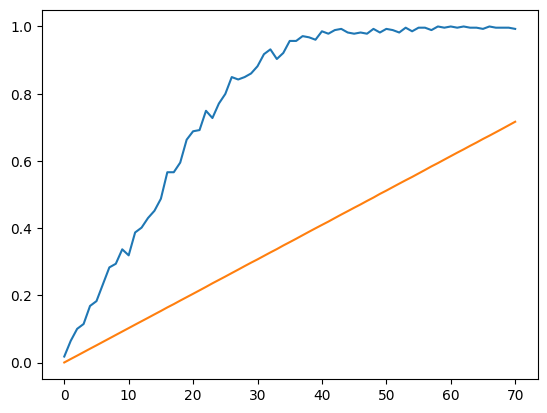

In [44]:
plt.plot(acc_train_list)
plt.plot(t)

In [36]:
t = acc_test_list

In [45]:
t

[0.00025,
 0.010553333333333333,
 0.020606666666666662,
 0.030909999999999997,
 0.041213333333333324,
 0.05126666666666666,
 0.06157,
 0.07179,
 0.08209333333333331,
 0.09231333333333333,
 0.10253333333333332,
 0.11283666666666664,
 0.12297333333333332,
 0.13311,
 0.14341333333333334,
 0.15355000000000002,
 0.1641033333333333,
 0.17390666666666668,
 0.1843766666666667,
 0.19451333333333334,
 0.20464999999999997,
 0.21487,
 0.2251733333333333,
 0.23581,
 0.24586333333333332,
 0.2559166666666666,
 0.26630333333333334,
 0.27652333333333334,
 0.2869933333333333,
 0.29721333333333333,
 0.3070166666666667,
 0.31740333333333326,
 0.32770666666666665,
 0.3375933333333333,
 0.3483133333333334,
 0.3582833333333333,
 0.36841999999999997,
 0.37888999999999995,
 0.38927666666666666,
 0.3994966666666667,
 0.40954999999999997,
 0.4194366666666665,
 0.4299900000000001,
 0.44037666666666664,
 0.45042999999999994,
 0.4606500000000001,
 0.47053666666666666,
 0.48100666666666664,
 0.4909766666666666,
 0.5

In [46]:
for i in range(len(acc_train_list)):
    t[i] = t[i]

In [ ]:
a = torch.zeros((3, 224, 224))
b = torch.zeros((1, 224, 224))

In [67]:
torch.cat((a,b)).shape

torch.Size([4, 224, 224])